In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import matplotlib
matplotlib.rcParams['figure.figsize'] = (8, 5)

import warnings
warnings.filterwarnings('ignore')

# Boostings

Данные с которыми вы будете работать представляют из себя характеристики клиента страховой компании по которым нужно понять будет ли он заинтересован в страховке. Таким образом, страховая компания может более оптимально таргетить рекламу и выстраивать коммуникацию с клиентами, повышая конверсию.

**Описания колонок:**
- Gender - Male, Female
- Age - Возраст
- Driving_License - Наличие водительского удостоверения
- Region_Code - Область проживания
- Previously_Insured - Пользовался ли раньше услугами страховой компании
- Vehicle_Age - Возраст транспортного средства
- Vehicle_Damage - Попадало ли траспортное средство в ДТП
- Annual_Premium - Ежегодные выплаты клиента
- Policy_Sales_Channel - Политика распространения страховых услуг (через посредников, напрямую и т.д.)
- Vintage - Количество дней, в течение которых клиент был связан с компанией 


- **Response** - заинтересован в страховке 1, не откликнулся 0

In [2]:
data = pd.read_csv('vehicle_insurance.csv')

data

,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response
0,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1
1,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0
2,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1
3,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0
4,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0
...,...,...,...,...,...,...,...,...,...,...,...
9995,Female,24,1,37.0,1,< 1 Year,No,21243.0,152.0,21,0
9996,Male,28,1,35.0,1,< 1 Year,No,23589.0,160.0,173,0
9997,Female,27,1,15.0,0,< 1 Year,Yes,33340.0,152.0,207,0
9998,Female,28,1,14.0,1,< 1 Year,No,25426.0,152.0,247,0


**Задание 0.** Проведите небольшой EDA. Посмотрите на распределения некоторых колонок, на матрицу корреляций. Также проверьте баланс классов и посмотрите на распределение возраста транспортного средства в зависимости от response. \
Закодируйте признаки типа `object` с помощью `one-hot` кодирования.

P.S. некоторые не `object`колонки по смыслу очевидно являются категориальными. Так как мы будем строить ансамбли на основе деревьев, их можно оставить в первоначальном виде.

In [3]:
data.describe()

,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,38.812900,0.997800,26.425400,0.443800,30609.649700,112.414400,155.560300,0.124700
std,15.514785,0.046855,13.153552,0.496856,16562.392967,53.975042,83.923849,0.330395
min,20.000000,0.000000,0.000000,0.000000,2630.000000,1.000000,10.000000,0.000000
25%,25.000000,1.000000,15.000000,0.000000,24458.250000,30.000000,83.000000,0.000000
50%,36.000000,1.000000,28.000000,0.000000,31746.000000,136.000000,156.000000,0.000000
75%,49.000000,1.000000,35.000000,1.000000,39572.250000,152.000000,228.000000,0.000000
max,84.000000,1.000000,52.000000,1.000000,267698.000000,163.000000,299.000000,1.000000


In [4]:
X = data.drop('Response', axis=1)
y = data['Response']

numeric_columns = list(X.loc[:,X.dtypes!=object].columns)
categorical_columns = list(X.loc[:,X.dtypes==object].columns)

In [5]:
categorical_columns

['Gender', 'Vehicle_Age', 'Vehicle_Damage']

In [6]:
numeric_columns

['Age',
 'Driving_License',
 'Region_Code',
 'Previously_Insured',
 'Annual_Premium',
 'Policy_Sales_Channel',
 'Vintage']

In [7]:
data = pd.get_dummies(data, columns=categorical_columns, drop_first=True)


In [8]:
data

,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response,Gender_Male,Vehicle_Age_< 1 Year,Vehicle_Age_> 2 Years,Vehicle_Damage_Yes
0,44,1,28.0,0,40454.0,26.0,217,1,True,False,True,True
1,76,1,3.0,0,33536.0,26.0,183,0,True,False,False,False
2,47,1,28.0,0,38294.0,26.0,27,1,True,False,True,True
3,21,1,11.0,1,28619.0,152.0,203,0,True,True,False,False
4,29,1,41.0,1,27496.0,152.0,39,0,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
9995,24,1,37.0,1,21243.0,152.0,21,0,False,True,False,False
9996,28,1,35.0,1,23589.0,160.0,173,0,True,True,False,False
9997,27,1,15.0,0,33340.0,152.0,207,0,False,True,False,True
9998,28,1,14.0,1,25426.0,152.0,247,0,False,True,False,False


In [9]:
### Your code is here




**Задание 1.** Обучите градиентный бустинг из sklearn на данных и замерьте accuracy и f1-score на тестовой выборке. В качестве параметров ансамбля установите `learning_rate = 1`, `random_state = 1`, `n_estimators = 100`. Изобразите ROC-кривую и посчитайте AUC, оцените качество классификации. (2б)

P.S. для всех прочих моделей в этом домашнем задании тоже фиксируйте `random_state = 1`. Как думаете, что может быть случайного в процедуре обучения градиентного бустинга?

In [10]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, f1_score, roc_curve, auc

X = data.drop('Response', axis=1)
y = data['Response']

X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    random_state=0,
                                                    shuffle=True,
                                                    test_size=0.2)

In [11]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import roc_auc_score, roc_curve

### Your code is here
model = GradientBoostingClassifier(learning_rate = 1, random_state = 1, n_estimators = 100)
model.fit(X_train, y_train)
acc_train = model.score(X_train, y_train)
acc_test = model.score(X_test, y_test)
y_scores = model.predict_proba(X_test)[:, 1]  # Вероятности для положительного класса

# 5. Вычисление AUC
auc_score = roc_auc_score(y_test, y_scores)
print(f"AUC: {auc_score:.3f}")
#print(round(acc_test, 3)) 


AUC: 0.828


**Задание 2.** Переберите параметры `n_estimators` и `learning_rate` по двумерной сетке. При обучении в цикле сразу считайте f1-score на тестовой выборке и сохраняйте результат в матрицу. Для какого алгоритма качество окажется максимальным?

Постройте кривые для метрики f1-score в зависимости от числа шагов для нескольких learning_rate. Изобразите heatmap полученной матрицы. Сделайте вывод, как количество шагов влияет на качество совместно с различной скоростью обучения? (2б)

P.S. для подсчета f1-score передайте в функцию параметр `average='weighted'`, чтобы учитывался еще и баланс классов (вспомните микро/макро-усреднения).

In [12]:
### Задаем сетку параметров

n_estimators_list = [5, 10, 20, 50, 100, 200, 700, 1000]
learning_rate_list = [1, 0.1, 0.01]

In [13]:
### Your code is here
for (i, n) in enumerate(n_estimators_list):
    for (j, lr) in enumerate(learning_rate_list):
        model = GradientBoostingClassifier(n_estimators=n,
                                           learning_rate=lr,
                                           max_depth=5,
                                           random_state=1)
        model.fit(X_train, y_train)        
        y_pred = model.predict(X_test)
        # 5. Вычисление F1-score
        f1 = f1_score(y_test, y_pred, average='weighted')
        print(f"F1-score: {f1:.3f}")






F1-score: 0.837
F1-score: 0.832
F1-score: 0.831
F1-score: 0.836
F1-score: 0.832
F1-score: 0.831
F1-score: 0.842
F1-score: 0.832
F1-score: 0.831
F1-score: 0.832
F1-score: 0.832
F1-score: 0.832
F1-score: 0.836
F1-score: 0.838
F1-score: 0.832
F1-score: 0.838
F1-score: 0.840
F1-score: 0.832
F1-score: 0.842
F1-score: 0.847
F1-score: 0.835
F1-score: 0.844
F1-score: 0.845
F1-score: 0.837


**Задание 3.** Вам потребуется обучить 4 модели и посчитать метрику f1-score на тестовой и обучающей выборках для каждой модели. 
1. Случайный лес с максимальной глубиной деревьев 5,
2. Случайный лес с максимальной глубиной деревьев 5000,
3. Градиентный бустинг с максимальной глубиной деревьев 5,
4. Градиентный бустинг с максимальной глубиной деревьев 5000.

Для каждой модели перебирайте значения `n_estimators`, как в предыдущем задании. Отрисуйте графики зависимости f1-score от количества шагов, используя `average='weighted'` для учёта баланса классов. 

Если в качестве базовой модели брать неглубокие деревья, то какая модель лучше запоминает обучающую выборку: случайный лес или градиентный бустинг? Какая из них лучше предсказывает на тестовой выборке? Как изменятся ответы, если базовая модель - это глубокое решающее дерево?

Подвержен ли переобучению случайный лес и градиентный бустинг? Как это отражается на графиках? (4б)

In [14]:
from sklearn.ensemble import RandomForestClassifier

n_estimators_list = [2, 3, 4, 5, 10, 20, 50, 70, 100, 200, 700, 1000, 2000]

### Your code is here

In [15]:
for (i, n) in enumerate(n_estimators_list):
    model = GradientBoostingClassifier(n_estimators=n,
                                           learning_rate=1,
                                           max_depth=5,
                                           random_state=1)
    model.fit(X_train, y_train)        
    y_pred = model.predict(X_test)
        # 5. Вычисление F1-score
    f1 = f1_score(y_test, y_pred, average='weighted')
    print(f"F1-score: {f1:.3f}")

F1-score: 0.831
F1-score: 0.831
F1-score: 0.832
F1-score: 0.837
F1-score: 0.836
F1-score: 0.842
F1-score: 0.832
F1-score: 0.835
F1-score: 0.836
F1-score: 0.838
F1-score: 0.842
F1-score: 0.844
F1-score: 0.842


In [16]:
for (i, n) in enumerate(n_estimators_list):
    model = GradientBoostingClassifier(n_estimators=n,
                                           learning_rate=1,
                                           max_depth=5000,
                                           random_state=1)
    model.fit(X_train, y_train)        
    y_pred = model.predict(X_test)
        # 5. Вычисление F1-score
    f1 = f1_score(y_test, y_pred, average='weighted')
    print(f"F1-score: {f1:.3f}")

F1-score: 0.836
F1-score: 0.836
F1-score: 0.836
F1-score: 0.835
F1-score: 0.835
F1-score: 0.834
F1-score: 0.834
F1-score: 0.834
F1-score: 0.834
F1-score: 0.834
F1-score: 0.834
F1-score: 0.834
F1-score: 0.834


In [17]:
for (i, n) in enumerate(n_estimators_list):
    model = RandomForestClassifier(n_estimators=n,
                                           #learning_rate=1,
                                           max_depth=5,
                                           random_state=1)
    model.fit(X_train, y_train)        
    y_pred = model.predict(X_test)
        # 5. Вычисление F1-score
    f1 = f1_score(y_test, y_pred, average='weighted')
    print(f"F1-score: {f1:.3f}")

F1-score: 0.834
F1-score: 0.833
F1-score: 0.831
F1-score: 0.833
F1-score: 0.831
F1-score: 0.831
F1-score: 0.831
F1-score: 0.831
F1-score: 0.831
F1-score: 0.831
F1-score: 0.831
F1-score: 0.831
F1-score: 0.831


In [18]:
for (i, n) in enumerate(n_estimators_list):
    model = RandomForestClassifier(n_estimators=n,
                                           #learning_rate=1,
                                           max_depth=5000,random_state=1)
    model.fit(X_train, y_train)        
    y_pred = model.predict(X_test)
        # 5. Вычисление F1-score
    f1 = f1_score(y_test, y_pred, average='weighted')
    print(f"F1-score: {f1:.3f}")

F1-score: 0.847
F1-score: 0.842
F1-score: 0.841
F1-score: 0.839
F1-score: 0.842
F1-score: 0.848
F1-score: 0.845
F1-score: 0.839
F1-score: 0.838
F1-score: 0.838
F1-score: 0.839
F1-score: 0.839
F1-score: 0.840


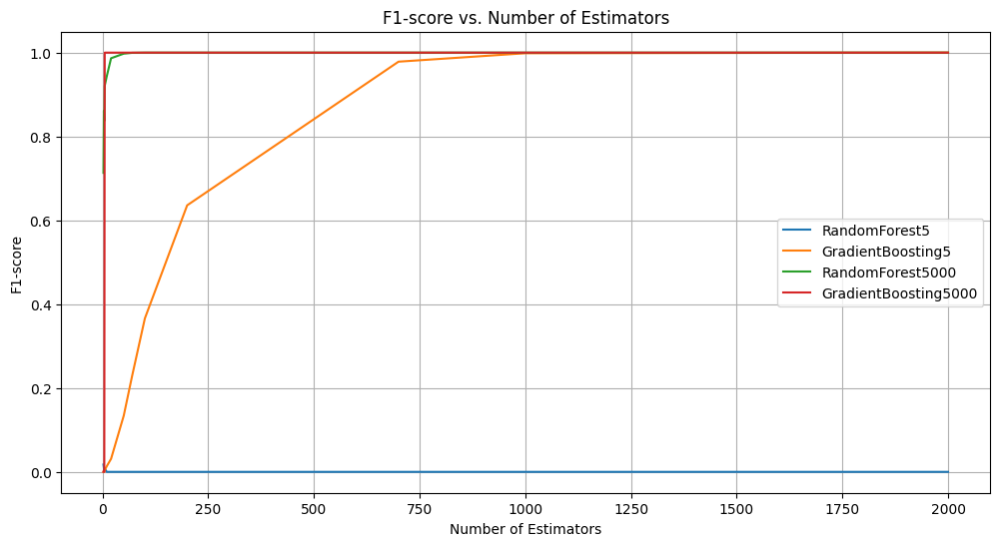

Модель, достигающая максимума F1-score быстрее всего: GradientBoosting5 с F1-score 1.0000


In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import f1_score

# 1. Создание искусственного набора данных
#X, y = make_classification(n_samples=1000, n_features=20, n_classes=2, random_state=42)

# 2. Разделение данных на обучающую и тестовую выборки
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 3. Определение значений n_estimators для перебора
#n_estimators_range = range(1, 101, 5)  # от 1 до 100 с шагом 5

# 4. Словарь для хранения результатов
results = {
    'RandomForest5': [],
    'GradientBoosting5': [],
    'RandomForest5000': [],
    'GradientBoosting5000': [],
}

# 5. Перебор значений n_estimators для каждой модели
for n in n_estimators_list:
    # Random Forest5
    rf_model = RandomForestClassifier(n_estimators=n, max_depth=5,random_state=1)
    rf_model.fit(X_train, y_train)
    rf_pred = rf_model.predict(X_train)
    rf_f15 = f1_score(y_train, rf_pred)
    results['RandomForest5'].append(rf_f15)

    # Gradient Boosting5
    gb_model = GradientBoostingClassifier(n_estimators=n, max_depth=5,random_state=1)
    gb_model.fit(X_train, y_train)
    gb_pred = gb_model.predict(X_train)
    gb_f15 = f1_score(y_train, gb_pred)
    results['GradientBoosting5'].append(gb_f15)

    # Random Forest5000
    rf_model = RandomForestClassifier(n_estimators=n, max_depth=5000,random_state=1)
    rf_model.fit(X_train, y_train)
    rf_pred = rf_model.predict(X_train)
    rf_f15000 = f1_score(y_train, rf_pred)
    results['RandomForest5000'].append(rf_f15000)

    # Gradient Boosting5000
    gb_model = GradientBoostingClassifier(n_estimators=n, max_depth=5000,random_state=1)
    gb_model.fit(X_train, y_train)
    gb_pred = gb_model.predict(X_train)
    gb_f15000 = f1_score(y_train, gb_pred)
    results['GradientBoosting5000'].append(gb_f15000)


# 6. Построение графиков
plt.figure(figsize=(12, 6))
for model_name, f1_scores in results.items():
    plt.plot(n_estimators_list, f1_scores, label=model_name)

plt.title('F1-score vs. Number of Estimators')
plt.xlabel('Number of Estimators')
plt.ylabel('F1-score')
plt.legend()
plt.grid()
plt.show()

# 7. Определение модели с максимальным F1-score
max_f1_scores = {model: max(scores) for model, scores in results.items()}
best_model = max(max_f1_scores, key=max_f1_scores.get)
print(f"Модель, достигающая максимума F1-score быстрее всего: {best_model} с F1-score {max_f1_scores[best_model]:.4f}")



**Задание 4.** Установите библиотеку `catboost`. Главной особенностью catboost явялется наличие встроенной обработки категориальных признаков. Для каждого категориального столбца вычисляется следующее значение
$$
avg\_target = \dfrac{countInClass + prior}{totalCount + 1},
$$
* countInClass - количество объектов положительного класса для данной категории **до текущего объекта**,
* prior - некоторая константа для числителя, обычно равна доле положительного класса в таргете,
* totalCount - количество наблюдаемых категорий вплоть **до текущего** с той же категорией, что и у текущего.

Так как первые такие значения будут иметь больший разброс, чем последние, то выборку перемешивают несколько раз и полученные статистики усредняют. 
В отличие от target encoder подсчитанные значения зависят от наблюдаемой истории, т.е. вычисляются только из наблюдений до них, таким образом не происходит target leakage. 

Почитать подробнее можно здесь: [Transforming categorical features](https://catboost.ai/en/docs/concepts/algorithm-main-stages_cat-to-numberic)

Обучите CatBoostClassifier с дефолтными параметрами. Используйте датасет до  (разбейте на train/test по старой логике с тем же random state'ом). Категориальные колонки передайте в параметр `cat_features` метода `fit`. Catboost сам с ними разберется.

Сравните качество с моделью из предыдущего задания. Стало ли лучше?

Сравните feature importances в модели из задания 2 и в catboost с помощью соответствующих методов, изобразите их, используя `barplot`. \
Какие признаки стали более важными с новым методом кодирования? (4б)

In [ ]:
!pip install catboost

  Using cached numpy-2.2.4-cp311-cp311-win_amd64.whl.metadata (60 kB)
  Using cached scipy-1.15.2-cp311-cp311-win_amd64.whl.metadata (60 kB)
  Using cached pandas-2.2.3-cp311-cp311-win_amd64.whl.metadata (19 kB)
  Using cached scikit_learn-1.6.1-cp311-cp311-win_amd64.whl.metadata (15 kB)
  Using cached python_dateutil-2.9.0.post0-py2.py3-none-any.whl.metadata (8.4 kB)
  Using cached pytz-2025.2-py2.py3-none-any.whl.metadata (22 kB)
  Using cached joblib-1.4.2-py3-none-any.whl.metadata (5.4 kB)
  Using cached threadpoolctl-3.6.0-py3-none-any.whl.metadata (13 kB)
  Using cached six-1.17.0-py2.py3-none-any.whl.metadata (1.7 kB)
Using cached numpy-2.2.4-cp311-cp311-win_amd64.whl (12.9 MB)
Using cached scipy-1.15.2-cp311-cp311-win_amd64.whl (41.2 MB)
Using cached pandas-2.2.3-cp311-cp311-win_amd64.whl (11.6 MB)
Using cached scikit_learn-1.6.1-cp311-cp311-win_amd64.whl (11.1 MB)
Using cached joblib-1.4.2-py3-none-any.whl (301 kB)
Using cached python_dateutil-2.9.0.post0-py2.py3-none-any.whl 

  You can safely remove it manually.
  You can safely remove it manually.
  You can safely remove it manually.
  You can safely remove it manually.
  You can safely remove it manually.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
catboost 1.2.7 requires numpy<2.0,>=1.16.0, but you have numpy 2.2.4 which is incompatible.


In [25]:
from catboost import CatBoostClassifier

data = pd.read_csv('vehicle_insurance.csv')

X = data.drop('Response', axis=1)
y = data['Response']

numeric_columns = list(X.loc[:,X.dtypes!=object].columns)
categorical_columns = list(X.loc[:,X.dtypes==object].columns)


### Your code is here
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    random_state=0,
                                                    shuffle=True,
                                                    test_size=0.2)
catboost = CatBoostClassifier()
catboost.fit(X_train, y_train, cat_features = categorical_columns)

test_preds = catboost.predict(X_test)
test_error = np.mean((test_preds - y_test.values.ravel())**2)
print(round(test_error, 3))



ValueError: numpy.dtype size changed, may indicate binary incompatibility. Expected 96 from C header, got 88 from PyObject

In [ ]:
print(catboost.get_feature_importance())

[ 3.1033428  11.36658464  0.03227638  7.43228013 27.35891126  4.74671151
 21.36760853  9.26128996  6.2198574   9.11113739]


In [ ]:
importances = catboost.get_feature_importance()
#feature_names = [f'Feature {i}' for i in range(X.shape[1])]
# 5. Создание DataFrame для визуализации
feature_names = [f'Feature {i}' for i in range(X.shape[1])]
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
})

# 6. Сортировка по важности
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# 7. Вывод наиболее значимых признаков
print("Наиболее значимые признаки:")
print(importance_df.head(10)) 

Наиболее значимые признаки:
     Feature  Importance
4  Feature 4   27.358911
6  Feature 6   21.367609
1  Feature 1   11.366585
7  Feature 7    9.261290
9  Feature 9    9.111137
3  Feature 3    7.432280
8  Feature 8    6.219857
5  Feature 5    4.746712
0  Feature 0    3.103343
2  Feature 2    0.032276


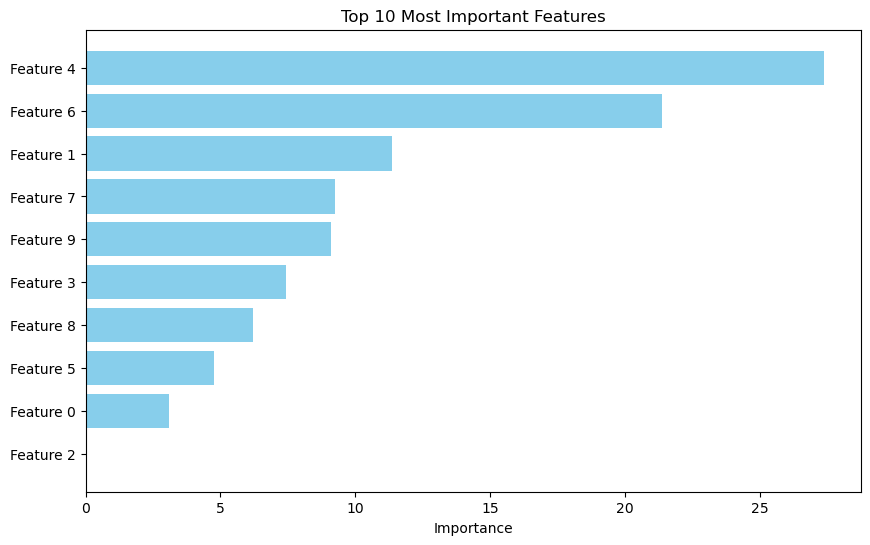

In [ ]:
plt.figure(figsize=(10, 6))
plt.barh(importance_df['Feature'][:10], importance_df['Importance'][:10], color='skyblue')
plt.xlabel('Importance')
plt.title('Top 10 Most Important Features')
plt.gca().invert_yaxis()  # Инвертируем ось Y для лучшего отображения
plt.show()

In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from catboost import CatBoostClassifier

# 1. Создание искусственного набора данных
X, y = make_classification(n_samples=1000, n_features=20, n_classes=2, random_state=42)

# 2. Разделение данных на обучающую и тестовую выборки
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 3. Обучение модели Random Forest
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# 4. Обучение модели CatBoost
catboost_model = CatBoostClassifier(iterations=100, learning_rate=0.1, depth=6, verbose=0)
catboost_model.fit(X_train, y_train)

# 5. Извлечение важностей признаков
rf_importances = rf_model.feature_importances_
catboost_importances = catboost_model.get_feature_importance()

# 6. Создание DataFrame для визуализации
feature_names = [f'Feature {i}' for i in range(X.shape[1])]
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Random Forest': rf_importances,
    'CatBoost': catboost_importances
})

# 7. Преобразование DataFrame для barplot
importance_df = importance_df.melt(id_vars='Feature', var_name='Model', value_name='Importance')

# 8. Построение barplot
plt.figure(figsize=(12, 6))
sns.barplot(data=importance_df, x='Importance', y='Feature', hue='Model')
plt.title('Feature Importances Comparison')
plt.xlabel('Importance')
plt.ylabel('Features')
plt.legend(title='Model')
plt.grid()
plt.show()



ValueError: numpy.dtype size changed, may indicate binary incompatibility. Expected 96 from C header, got 88 from PyObject

**Задание 5.** Установите библиотеку `lightgbm`. На сегодняшний день это наиболее быстрый метод градиентного бустинга, при этом расходующий небольшое количество оперативной памяти. Достигает он этого за счет построения деревьев вглубь по листьям (leaf-wise), а не по уровням (level-wise), как другие методы, например XGBoost. 
Более понятно это на картинке:

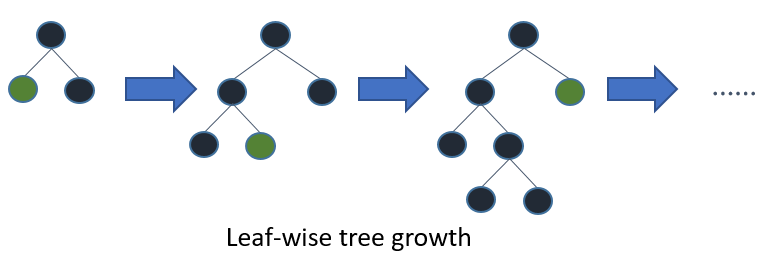

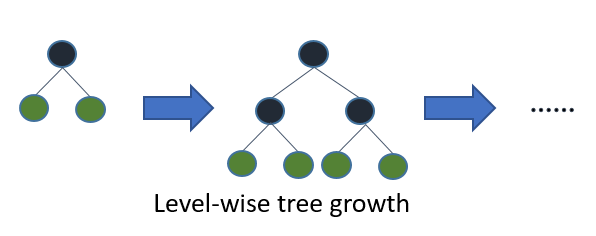

В то время, как XGBoost за раз разделяет вершины на целом уровне той же глубины, LightGBM разделяет одну вершину за раз. Отсюда прирост в скорости.

Обучите `LGBMClassifier` на изначальных(закодированных) данных и добейтесь максимального качества на тестовой выборке, перебрав параметры глубины деревьев, количества шагов, скорости обучения и т.д.

In [52]:
!pip install lightgbm

   ---------------------------------------- 0.0/1.5 MB ? eta -:--:--
   -------------- ------------------------- 0.5/1.5 MB 3.4 MB/s eta 0:00:01
   ---------------------------- ----------- 1.0/1.5 MB 3.1 MB/s eta 0:00:01
   ---------------------------------------- 1.5/1.5 MB 3.3 MB/s eta 0:00:00


In [64]:
data = pd.read_csv('vehicle_insurance.csv')

X = data.drop('Response', axis=1)
y = data['Response']

numeric_columns = list(X.loc[:,X.dtypes!=object].columns)
categorical_columns = list(X.loc[:,X.dtypes==object].columns)

data = pd.get_dummies(data, columns=categorical_columns, drop_first=True)
data

X = data.drop('Response', axis=1)
y = data['Response']

In [69]:
X

,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Gender_Male,Vehicle_Age_< 1 Year,Vehicle_Age_> 2 Years,Vehicle_Damage_Yes
0,44,1,28.0,0,40454.0,26.0,217,True,False,True,True
1,76,1,3.0,0,33536.0,26.0,183,True,False,False,False
2,47,1,28.0,0,38294.0,26.0,27,True,False,True,True
3,21,1,11.0,1,28619.0,152.0,203,True,True,False,False
4,29,1,41.0,1,27496.0,152.0,39,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...
9995,24,1,37.0,1,21243.0,152.0,21,False,True,False,False
9996,28,1,35.0,1,23589.0,160.0,173,True,True,False,False
9997,27,1,15.0,0,33340.0,152.0,207,False,True,False,True
9998,28,1,14.0,1,25426.0,152.0,247,False,True,False,False


In [ ]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import GridSearchCV

params = {'n_estimators': [100, 500, 1000, 2000],
          'max_depth': [2, 3, 5, 100],
          'learning_rate': [0.1, 0.01, 0.001]}

### Your code is here

lgbms = LGBMClassifier()
lgbms.fit(X_train, y_train)

search = GridSearchCV(lgbms, param_grid=params)

search.fit(X_train, y_train)

y_pred = search.predict(X_test)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 1012, number of negative: 6988
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001167 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 685
[LightGBM] [Info] Number of data points in the train set: 8000, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.126500 -> initscore=-1.932266
[LightGBM] [Info] Start training from score -1.932266
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 810, number of negative: 5590
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000746 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 683
[LightGBM] [Info] Number of data points in the train set: 6400, number of used features

In [ ]:
from sklearn.metrics import precision_score
y_pred = lgbms.predict(X_test)

round(precision_score(y_true=y_test, y_pred = y_pred, pos_label=0),2)

In [ ]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import GridSearchCV




### Your code is here
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    random_state=1, #0,
                                                    shuffle=True,
                                                    test_size=0.2)



params = {'n_estimators': [100, 500, 1000, 2000],
          'max_depth': [2, 3, 5, 100],
          'learning_rate': [0.1, 0.01, 0.001]}

### Your code is here
#gbm = LGBMClassifier()

grid = GridSearchCV(LGBMClassifier(), params, scoring='precision', verbose=3, n_jobs=-1)
grid.fit(X_train, y_train)

best_params = grid.best_params_
print("Лучшие параметры:", best_params)

# 8. Оценка модели на тестовой выборке
y_pred = grid.predict(X_test)

# 9. Вычисление precision для класса 0
precision_class_0 = precision_score(y_test, y_pred, pos_label=0)
print("Precision для класса 0:", round(precision_class_0, 2))


Fitting 5 folds for each of 48 candidates, totalling 240 fits
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 810, number of negative: 5590
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000109 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 683
[LightGBM] [Info] Number of data points in the train set: 6400, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.126562 -> initscore=-1.931700
[LightGBM] [Info] Start training from score -1.931700
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Ligh